# DESCARGAR IMAGENES USANDO BING SCRAPER

En este notebook vamos a adquirir un conjunto de datos en base a una oracion a buscar. Para el proyecto de deteccion de personas con/sin mascarilla necesitamos justamente estos datasets.

Por lo tanto, nuestra primera oraciona  buscar sera 'people_in_street' y la segunda para el otro dataset people+with+masks+in+street. 


In [ ]:
import math
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tqdm import tqdm
%matplotlib inline

In [ ]:
!pip install selenium
!apt-get update # to update ubuntu to correctly run apt install
!apt install chromium-chromedriver
!cp /usr/lib/chromium-browser/chromedriver /usr/bin
import sys
sys.path.insert(0,'/usr/lib/chromium-browser/chromedriver')


     |████████████████████████████████| 911kB 7.8MB/s 
Hit:1 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:2 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Get:3 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:4 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 kB]
Hit:5 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease
Get:6 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran35/ InRelease [3,626 B]
Get:7 http://ppa.launchpad.net/marutter/c2d4u3.5/ubuntu bionic InRelease [15.4 kB]
Ign:8 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Ign:9 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:10 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release
Get:11 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release [564 B]
Get:12 https://devel

In [ ]:
!git clone https://github.com/ultralytics/google-images-download
!cd google-images-download && pip install -U -r requirements.txt

Cloning into 'google-images-download'...
remote: Enumerating objects: 710, done.
remote: Total 710 (delta 0), reused 0 (delta 0), pack-reused 710
Receiving objects: 100% (710/710), 293.79 KiB | 958.00 KiB/s, done.
Resolving deltas: 100% (400/400), done.
     |████████████████████████████████| 71kB 4.6MB/s 
Requirement already up-to-date: selenium in /usr/local/lib/python3.6/dist-packages (from -r requirements.txt (line 2)) (3.141.0)
  Found existing installation: tqdm 4.41.1
    Uninstalling tqdm-4.41.1:
      Successfully uninstalled tqdm-4.41.1


# Adquirir imagenes

Se lograron descargar 730 imagenes de personas sin mascarilla y 737 imagenes de personas con mascarilla. Hay falsos positivos en ambos dominios por lo cual es necesario tratar estos errores manualmente. Para los falsos negativos, no se hara ningun tratamiento.

Vamos a usar algunas funciones de javascript para obtener imagenes desde el buscador de Bing.

In [ ]:
!python google-images-download/bing_scraper.py -o imagenes -i people_in_street --url 'https://www.bing.com/images/search?q=people_in_street' --limit 2000 --download --chromedriver chromedriver 

Searching for https://www.bing.com/images/search?q=people_in_street
1/2000 URLError on an image...trying next one... Error: HTTP Error 404: Not Found
1/2000 https://images.pexels.com/photos/34692/pexels-photo.jpg 
2/2000 https://research.umn.edu/sites/research.umn.edu/files/styles/ovpr_large/public/blog-crowd-multi-racial.png 
3/2000 https://jooinn.com/images/crossing-nyc-2.png 
4/2000 https://calgarypeople.files.wordpress.com/2013/01/calgary-people-2-street-rob-moses-photography.jpg 
5/2000 https://www.livingstreets.org.uk/media/1066/city-walk.png 
6/2000 http://georgesoules.com/wp-content/uploads/2013/07/Street-Image.jpg 
7/2000 http://vancouver.ca/images/cov/feature/people-walking-commercial-drive-facebook.jpg 
8/2000 https://static01.nyt.com/images/2017/10/24/business/24ITINERARIES1/24ITINERARIES1-superJumbo.jpg 
9/2000 https://epha.org/wp-content/uploads/2017/12/people-crossing-the-road.jpg 
10/2000 https://petapixel.com/assets/uploads/2017/11/finger-800x600.jpg 
11/2000 https://i

In [ ]:
!python google-images-download/bing_scraper.py -o imagenes -i people_with_masks_v2 --url 'https://www.bing.com/images/search?q=people+with+masks+in+street' --limit 2000 --download --chromedriver chromedriver 

Searching for https://www.bing.com/images/search?q=people+with+masks+in+street
1/2000 http://i.dailymail.co.uk/i/pix/2016/07/22/16/3680CE1100000578-3701540-image-a-90_1469199646764.jpg 
2/2000 https://image.freepik.com/free-photo/people-mask-standing-street_1157-34138.jpg 
3/2000 https://whyfiles.org/wp-content/uploads/2013/10/shutterstock_japan.jpg 
4/2000 https://image.freepik.com/free-photo/people-masks-stands-street_1157-35641.jpg 
5/2000 https://image.freepik.com/free-photo/people-masks-stands-street_1157-31589.jpg 
6/2000 https://media.gettyimages.com/photos/people-wearing-face-masks-walk-along-a-street-during-heavy-pollution-picture-id1057998004 Invalid or missing image format. Skipping...
6/2000 https://image.freepik.com/free-photo/people-masks-stands-street_1157-31567.jpg 
7/2000 https://image.freepik.com/free-photo/people-masks-stands-street_1157-31573.jpg 
8/2000 http://bsmedia.business-standard.com/_media/bs/img/photo-gallery/general/people-in-beijing-choked-by-smog-as-poll

In [ ]:
#limpiar archivos corruptos, es decir, aquellos que no puedan ser abiertos

def limpiar_archivos_corruptos(path, format='.jpg'):   
  for filename in os.listdir(path):
    if filename.endswith(format):
      try:
        img = Image.open(os.path.join(path,filename)) # open the image file
        img.verify() # verify that it is, in fact an image
      except:
        os.remove(os.path.join(path,filename))
        print('Removiendo archivo corrupto:', filename) # print out the names of corrupt files
#limpiar_archivos_corruptos('imagenes/people_in_street')
limpiar_archivos_corruptos('imagenes/people_with_masks_v2')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


## Cargar las imagenes

Observamos algunas imagenes de ejemplo para validar el resultado. Ademas, guardamos estas imagenes en un drive compartido por el equipo.

In [ ]:
path = 'imagenes'

In [ ]:
img_size = 224
batch_size = 64

In [ ]:
# Especificamos la función de preprocesamiento
train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input, validation_split=0.2)

In [ ]:
train_generator = train_datagen.flow_from_directory(path, target_size=(img_size, img_size), batch_size=batch_size, subset='training')

Found 588 images belonging to 1 classes.


In [ ]:
validation_generator = train_datagen.flow_from_directory(path, target_size=(img_size, img_size), batch_size=batch_size, subset='validation')

Found 147 images belonging to 1 classes.


people_with_masks_v2/708.obama_33119927.jpg


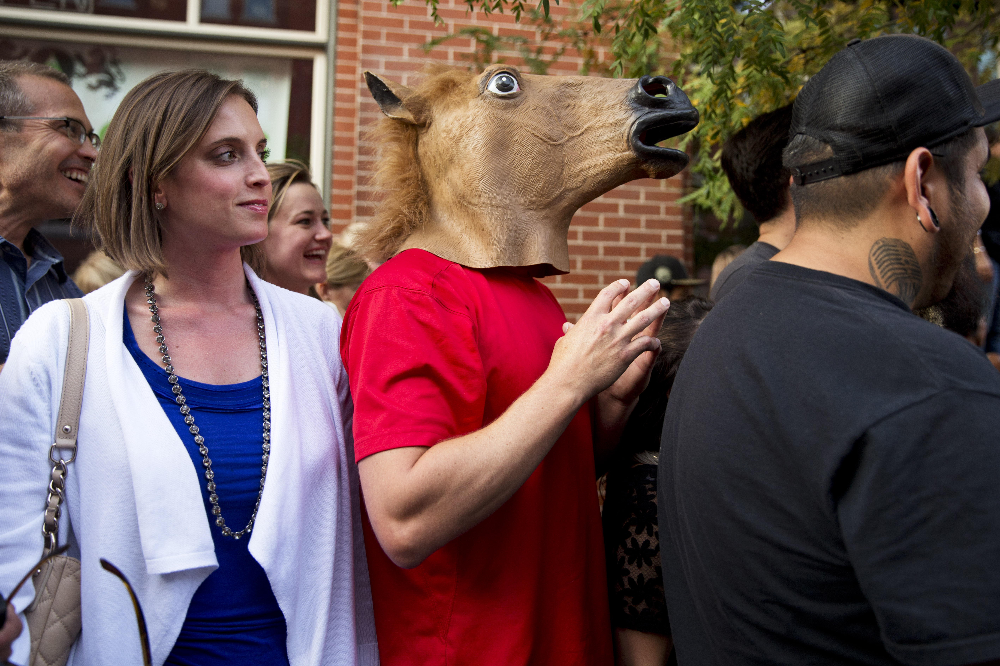

In [ ]:
# Veamos alguna de las imágenes
random_img = np.random.choice(train_generator.filenames)
print(random_img)
Image.open(path + '/' + random_img)

In [ ]:
validation_generator.filenames

['people_with_masks_v2/1.3680CE1100000578-3701540-image-a-90_1469199646764.jpg',
 'people_with_masks_v2/10.people-masks-stands-street_1157-31568.jpg',
 'people_with_masks_v2/100.london-uk-july-28-2019-people-watching-street-performance-young-asian-woman-wearing-pollution-face-mask-w6nrn2.jpg',
 'people_with_masks_v2/101.afre-people-cadiz-carnival-dressed-up-different-colorful-dresses-costumes-masks-cadiz-carnal-people-111705476.jpg',
 'people_with_masks_v2/102.Halloween-Street-Snaps-2011-10-29-G5348.jpg',
 'people_with_masks_v2/103.man-wearing-protective-mask-walking-street_1157-32347.jpg',
 'people_with_masks_v2/104.people-wear-mask-protection-street-style-london-uk-february-short-haired-boy-wears-protective-black-arrows-172694450.jpg',
 'people_with_masks_v2/105.people-wear-mask-protection-street-style-london-uk-february-stylish-woman-black-dress-coat-wide-brimmed-hat-wears-172694433.jpg',
 'people_with_masks_v2/106.london-uk-february-people-wear-mask-protection-street-style-young-ma

In [ ]:
# Nro de pruebas
n = 10

for _ in range(n):
    # Escoger una imagene al azar
    random_path = path + '/' + np.random.choice(validation_generator.filenames)
    print(random_path)

    # Obtener la clasificación de la imagen
    #get_class(random_path)

imagenes/people_with_masks_v2/2.people-mask-standing-street_1157-34138.jpg
imagenes/people_with_masks_v2/110.5287_two-street-artists-with-masks.jpg
imagenes/people_with_masks_v2/229.3b5379ccfff396cac8d3a568fdaa56c6.jpg
imagenes/people_with_masks_v2/214.people-wear-mask-protection-street-style-london-uk-february-stylish-woman-black-dress-coat-wide-brimmed-hat-wears-172694421.jpg
imagenes/people_with_masks_v2/182.venice-february-colourful-carnival-mask-streets-venice-st-mark-s-square-celebration-most-67670890.jpg
imagenes/people_with_masks_v2/23.people-mask-standing-street_1157-34154.jpg
imagenes/people_with_masks_v2/205.asian-people-street-wearing-protective-260nw-584407723.jpg
imagenes/people_with_masks_v2/23.people-mask-standing-street_1157-34154.jpg
imagenes/people_with_masks_v2/119.Street-artist-Phlegm-reveals-what-happens-behind-the-mask-that-most-people-wear-in-life.jpg
imagenes/people_with_masks_v2/124.people-wear-mask-protection-street-style-london-uk-february-stylish-woman-blac

In [ ]:
!zip -r /content/people_with_masks.zip /content/imagenes

  adding: content/imagenes/ (stored 0%)
  adding: content/imagenes/people_with_masks_v2/ (stored 0%)
  adding: content/imagenes/people_with_masks_v2/424.Masked-Children-110th-Street-NY-1969-by-Arthur-Tress.jpg (deflated 12%)
  adding: content/imagenes/people_with_masks_v2/637.773ce1a5f78c38b50ff63f6972b4a3d4.jpg (deflated 0%)
  adding: content/imagenes/people_with_masks_v2/586._76486263_pa-16676762111213.jpg (deflated 3%)
  adding: content/imagenes/people_with_masks_v2/81.d06a086c395d51b8333edf7aad01bdf7.jpg (deflated 0%)
  adding: content/imagenes/people_with_masks_v2/662.people-in-beautiful-fancy-dress-costumes-and-mask-on-st-marks-square-M6RT18.jpg (deflated 1%)
  adding: content/imagenes/people_with_masks_v2/625.4003.jpg (deflated 1%)
  adding: content/imagenes/people_with_masks_v2/468.horse_x4.jpg (deflated 0%)
  adding: content/imagenes/people_with_masks_v2/327.886403a77b902c99303b3785b8ef3d43--man-fashion-street-fashion.jpg (deflated 0%)
  adding: content/imagenes/people_with_ma

In [ ]:
from google.colab import files
files.download("/content/file.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!mv /content/people_with_masks.zip "/content/drive/My Drive/DEEP_LEARNING_MAESTRIA_PUCP/proyecto/detector_de_mascarillas"